<center>
<h1> <b>Métodos numéricos</b> </h1>
<h3> <b>Segundo cuatrimestre 2021</b> </h3>
<br>
<h1> <b>Práctica 3: Ecuaciones hiperbólicas</b> </h1>
<h3> Cátedra: Pablo Dmitruk </h3>
<br>
<h3> Fecha límite de entrega: 8 de octubre de 2021 23:59 </h3>
</center>

### Entrega de:   **COMPLETAR CON SUS NOMBRES**

- [Ejercicios](#ejercicios)

- [Repaso teórico](#explicacion)

Si bien la temática de la práctica es la de **ecuaciones hiperbólicas**, para fijar ideas, y dado que las estrategias aquí vistas pueden generalizarse a otras EDPs hiperbólicas, **vamos a centrarnos en la ecuación de advección**,
\begin{equation*}
    \frac{\partial \boldsymbol f}{\partial t} + (\boldsymbol u \cdot \boldsymbol \nabla) \boldsymbol f = 0.
\end{equation*}
$\boldsymbol f$ es la cantidad advectada (que puede ser escalar o vectorial) y $\boldsymbol u$ es la velocidad de advección, que naturalmente tiene unidades de $[u] = L/T$ (longitud sobre tiempo).

Esta ecuación describe, por ejemplo, el transporte de una sustancia en un medio fluido, donde $\boldsymbol u$ es la velocidad del medio fluido. Notablemente, en el caso no-lineal $\boldsymbol f = \boldsymbol u$, se tiene la advección de momento del propio fluido (considerando densidad unitaria).

<a name="ejercicios"></a>

# **Ejercicios**

## **Problema 1: Estabilidad para la ecuación de advección 1D**

Dada la ecuación de advección lineal 1D
\begin{equation*}
\frac{\partial f}{\partial t} + u \frac{\partial f}{\partial x} = 0,
\end{equation*}
con $u > 0$, analice la estabilidad de los siguientes esquemas (no se preocupe por la consistencia de los mismos):

$\text{a)}$ el esquema de primer orden espacial y temporal aguas arriba (upwind):
\begin{equation*}
    \frac{f^{n+1}_j -  f^n_j}{\Delta t} + u \frac{f^n_j - f^n_{j-1}}{\Delta x} = 0,
\end{equation*}
a partir del análisis del dominio de dependencia;

$\text{b)}$ el esquema de primer orden espacial aguas abajo (downwind):
\begin{equation*}
    \frac{f^{n+1}_j -  f^n_j}{\Delta t} + u \frac{f^{n}_{j+1} - f^n_j}{\Delta x} = 0,
\end{equation*}
a partir del análisis del dominio de dependencia;

$\text{c)}$ los esquemas aguas arriba y aguas abajo mencionados previamente pero utilizando una descomposición en modos trigonométricos para el error.

$\text{d)}$ Mediante análisis dimensional obtenga (a menos de una constante) la condición CFL para la ecuación de advección y verifique que los casos estudiados previamente verifican una condición de ese tipo.

**Su resolución acá**

---

## **Problema 2: Esquema aguas arriba 1D - Operadores densos y ralos**

Considere la ecuación de advección 1D
\begin{equation*}
    \frac{\partial f}{\partial t} + u \frac{\partial f}{\partial x} = 0,
\end{equation*}
con condiciones de contorno periódicas y con valor inicial $f(x,0) = \mathrm{sen}(2\pi x)$ sobre el dominio $0\le x < 1$ y $0 \le t \le 10$. Considere $u = 1/2$.

Una manera de integrar este problema de manera estable es mediante el esquema aguas arriba de primer orden, donde el término espacial queda discretizado por
\begin{equation*}
    u \frac{\partial f}{\partial x} \approx u \frac{f_j - f_{j-1}}{\Delta x}.
\end{equation*}
Note que bajo las condiciones de contorno propuestas, este término puede representarse como
\begin{equation*}
    \left[u \frac{\partial f}{\partial x}\right]_{(\mathbf{x},t^n)} = u D_{-} \mathbf{f}^n,
\end{equation*}
con
\begin{equation*}
D_{-} = \frac{1}{\Delta x} \begin{pmatrix}
     1 &  0 & 0 & 0 & \dots & 0 & -1 \\
    -1 &  1 & 0 & 0 & \dots & 0 &  0 \\
     0 & -1 & 1 & 0 & \dots & 0 &  0 \\
    \vdots & \vdots & \vdots & \vdots & \ddots \vdots & \vdots \\
     0 & 0  & 0 & 0 & \dots & -1& 1
\end{pmatrix}, \qquad \qquad \mathbf{f}^n = \begin{pmatrix}
    f_0^n \\
    f_1^n \\
    f_2^n \\
    \vdots \\
    f_{N_x-2}^n\\
    f_{N_x-1}^n
\end{pmatrix}.
\end{equation*}

Usando dicha representación para las derivadas espaciales, integre este problema para $N_x = 2048$ puntos de grilla en la dirección espacial junto con un integrador de Euler adelantado en tiempo, empleando un paso temporal apropiado dado por la condición de CFL. Realice esta tarea utilizando:

$\text{a)}$ una representación densa para la matriz $D_{-}$ (i.e. un arreglo Numpy tradicional);

$\text{b)}$ una [representación rala](#sparse) para la matriz $D_{-}$ (puede usar la función `scipy.sparse.diag` para construir dicha matriz).

Verifique que en ambos casos obtiene la solución analítica $\mathrm{sen}(2\pi(x-ut))$ (eventualmente con una progresiva atenuación para tiempos largos) y cronometre el tiempo de ejecución de cada estrategia (puede usar el comando [`%%time`](https://ipython.readthedocs.io/en/stable/interactive/magics.html#magic-time)). Debería notar una diferencia del tiempo de ejecución de orden 100x.

_Sugerencia: integre para tiempos y resoluciones menores hasta tener cierta confianza en que está integrando correctamente._

**Su resolución acá**

In [ ]:
%%time
# Su resolución densa acá

In [ ]:
%%time
# Su resolución rala acá

---

## **Problema 3: Orden de esquemas aguas arriba 1D**

El problema del ejercicio anterior posee como solución
\begin{equation*}
    f(x,t) = \mathrm{sen}\big(2\pi (x-t/2) \big).
\end{equation*}

Considerando de nuevo el esquema de aguas arriba de primer orden integre nuevamente el sistema para las combinaciones $(N_x; \Delta t) \in \{ (64; 5 \times 10^{-3}); (128; 2,5 \times 10^{-3}); (256;1 \times 10^{-3}); (512; 5 \times 10^{-4}); (1024; 2,5 \times 10^{-4}) \}$ utilizando como integradores temporales

$\text{a)}$ Euler adelantado;

$\text{b)}$ Runge-Kutta de segundo orden (punto medio);

_Sugerencia: utilice la [técnica sugerida](#rk) para programar Euler adelantado (Runge-Kutta de 1 etapa) y Runge-Kutta punto medio de manera simple_.

$\text{c)}$ Grafique la norma infinito del error (i.e., el máximo error para cada combinación $(N_x, \Delta t)$) en función de $\Delta t$ para ambos integradores temporales e intente estimar un orden de convergencia.

$\text{d)}$ Integre nuevamente el problema, tanto para Euler adelantado como para Runge-Kutta punto medio pero considerando ahora el siguiente esquema de aguas arriba de segundo orden espacial:
\begin{equation*}
    u \frac{\partial f}{\partial x} \approx u \frac{3f_j - 4f_{j-1} + f_{j-2}}{2\Delta x}.    
\end{equation*}

$\text{e)}$ Repita el inciso $\text{c)}$ para el esquema aguas arriba de segundo orden previamente mencionado.

**Su resolución acá**

In [ ]:
# Su resolución acá

---

## **Problema 4: Dispersión numérica**

Considere ahora la ecuación de advección con $u = 1/2$, con condiciones de contorno periódicas, y con la siguiente condición inicial
\begin{equation*}
    f(x,0) = \mathrm{sen}(10\pi x),
\end{equation*}
definida en el dominio $x \in [0, 1)$, $t \in [0, 50]$. Integre este problema utilizando:

> $\text{a)}$ un método de aguas arriba de primer orden para la derivada espacial y el método de Euler adelantado para integrar en tiempo;

> $\text{b)}$ un método de aguas arriba de segundo orden junto con un integrador de Runge-Kutta de segundo orden;

> $\text{c)}$ diferencias finitas centradas de cuarto orden para la derivada espacial y un método de Adams-Bashfort de 4to orden para la parte temporal;

> $\text{d)}$ grafique las soluciones que provee cada método para $t=0$; $t=1,2$ y $t=45,8$ y verifique que los métodos de órden más bajo reproducen la velocidad de fase de la solución real (i.e. $0,5$) de manera inadecuada.

> $\text{e)}$ **(OPCIONAL)** Utilice la función [`grafico1d_animado`](#grafico1d_animado) para obtener una representación animada del desfasaje progresivo entre las soluciones.

_Utilice en todos los casos $N_x=128$ puntos de grilla y un paso temporal $\Delta t = 2,5 \times 10^{-3}$ e imprima a qué condición de CFL corresponde esta elección._

**Su resolución acá**

In [ ]:
# Su solución acá

---

## **Problema 5: Difusión numérica**

Considere ahora la advección periódica con velocidad $u=1/2$ de un pulso supergausiano
\begin{equation*}
    f(x,0) = A e^{- \frac{(x-x_0)^{2p}}{L_p^{2p}}}, \qquad \qquad L_p=\sqrt{2} L \left(\frac{2p-1}{2p}\right)^{1/2p},
\end{equation*}
con $A$ la amplitud del pulso, $L$ una longitud característica del mismo, $x_0$ el centro del mismo a $t=0$ y $p$ un parámetro que controla la magnitud de los gradientes del pulso.

Considerando en particular condiciones de contorno periódicas, el dominio $x \in [0, 1)$, $t \in [0, 50]$ y los valores $A=1$; $x_0 = 0,5$; $L=0,2$ y $p=1$:

> $\text{a)}$ escriba una función que integre numéricamente el problema utilizando un esquema aguas arriba de primer orden conjugado con un método de Euler adelantado;

> $\text{b)}$ repita lo hecho en $a)$ pero utilizando ahora un esquema de aguas arriba de segundo orden espacial y un integrador de Runge-Kutta de segundo orden;

> $\text{c)}$ ídem $\text{a)}$ y $\text{b)}$ pero utilizando diferencias finitas centradas de cuarto orden para el operador espacial y un método de Adams-Bashforth de 4to orden para la parte temporal;

> $\text{d)}$ grafique las soluciones obtenidas junto con la solución analítica para $t=0$, $t=1,2$ y $t=45,8$ (en tres pares de ejes separados). ¿Qué sucede con los métodos de bajo orden para tiempos largos? ;

> $\text{e)}$ grafique el espectro de potencias (i.e. el modulo al cuadrado de la transformada de Fourier) para cada uno de los tiempos mencionados. ¿Qué componentes espectrales son las primeras en perderse durante la integración? ¿A qué se debe esto?;

> $\text{f)}$ repita el estudio previo pero considerando ahora $p=4$ y $p=8$, ¿qué observa?.

Utilice en todos los casos $N_x = 128$ puntos para la grilla espacial y un $\Delta t$ apropiado para satisfacer la condición de CFL.

_Ayuda: la siguiente función define un pulso supergaussiano en un dominio periódico con período (espacial) $L_x$:_
```python
def super_gaussian(x, p, A, x0, L, LX):
    Lp = np.sqrt(2)*L*((2*p-1)/(2*p))**(1/(2*p))
    return A*np.exp( - ( ((x%LX) - x0)/Lp)**(2*p) )
```
_Recuerde que para obtener la solución exacta a tiempos posteriores basta con evaluar la condición inicial en $x-ut$._

**Su resolución acá**

In [ ]:
# Su resolución acá

---

## Problema 6: Ecuación de Burgers (no-lineal)

Dado el problema de Burgers invíscido con condiciones de contorno periódicas
\begin{equation*}
    \frac{\partial u}{\partial t} + u \frac{\partial u}{\partial x} = 0, \qquad \qquad u(x,0) = \mathrm{sen}\left( \frac{x}{4} \right),
\end{equation*}
definida sobre el dominio $x \in [0, 8\pi)$ y $t \in [0, 4)$, puede mostrarse que este sistema desarrolla una singularidad donde $|\partial_x u| \to \infty$ para $t=4$.

> $\text{a)}$ Muestre que la cantidad $ E(t) = \int_{0}^{8\pi} u^2(t) \ \mathrm{d}x$ es una cantidad conservada y por tanto no depende del tiempo.

> $\text{b)}$ Muestre que $\omega = \partial_x u$ satisface la ecuación de evolución
\begin{equation*}
    \frac{\partial \omega}{\partial t} + u \frac{\partial \omega}{\partial x} = \frac{D \omega}{D t} = -  \omega^2.
\end{equation*}
El operador $D/Dt$ es usualmente conocido como derivada material o derivada advectiva y su valor cuantifica la variación de una magnitud a medida que un elemento material es advectado por un fluido.

> $\text{c)}$ A partir de lo hallado en $\text{b)}$ describa cualitativamente que sucederá a medida que el flujo evoluciona con las zonas de gradientes positivos ($\omega > 0$) y negativos ($\omega < 0$). A raíz de esto, ¿qué tipo de estructura espera encontrar en la solución a tiempos largos?

> $\text{d)}$ Resuelva la ecuación de Burgers utilizando diferencias finitas centradas de segundo orden y un integrador temporal de Runge-Kutta de segundo orden. Grafique la solución para $t=0$, $t=0,5$ y $t=4$, verificando que obtiene el comportamiento esperado a partir de lo respondido anteriormente.

> $\text{e)}$ Grafique en escala logarítmica la variación de energía $\Delta E(t) = E(t) - E(0)$ para la solución numérica obtenida. Debería observar que esta cantidad aproximadamente como $\Delta E(t) \propto t^\alpha$. _Ayuda: para estudiar la conservación puede utilizar la energía promedio $E^n = N^{-1} \sum_{j=0}^{N-1} (u^n_j)^2$._

> $\text{f)}$ Repita los incisos $\text{d)}$ y $\text{e)}$ pero utilizando ahora el método de Arakawa para discretizar el término no lineal:
\begin{equation*}
    \frac{\mathrm{d} u_j}{\mathrm{d}t} = - \frac{1}{3}(u_{j+1} + u_j + u_{j-1})\left( \frac{u_{j+1} - u_{j-1}}{2}\right).
\end{equation*}
¿Observa alguna diferencia en la magnitud $\Delta E$? ¿Y en el exponente $\alpha$?
>
>_Nota: Puede resultarle útil mostrar que esta relación puede reescribirse como_
\begin{equation*}
    \frac{\mathrm{d} \mathbf{u}}{\mathrm{d}t} = - (A \mathbf{u}) (D_x^{(2)} \mathbf{u}),
\end{equation*}
_con $[\mathbf{u}]_j = u_j$ y $A$ y $D_x^{(2)}$ matrices apropiadas._

> $\text{g)}$ Repita los incisos $\text{d)}$, $\text{e)}$ y $\text{f)}$ empleando un método de Runge-Kutta de 4to orden para la integración temporal. ¿Qué puede decir ahora sobre el exponente $\alpha$?

> $\text{h)}$ Compare finalmente la conservación de la energía en función del tiempo y la calidad de la solución numérica para $t=4$ utilizando un método de Arakawa (de 2do orden) y diferencias finitas centradas de cuarto orden.

En todos los casos considere $N_x = 512$ puntos de grilla y un paso $\Delta t$ apropiado dado por la condición CFL.

A modo de ayuda les proporcionamos a continuación un esqueleto (que ustedes deberán completar) de una función para integrar la ecuación de Burgers con condiciones de contorno periódicas. A la hora de implementar la funcionalidad de un dado bloque de código, deben remover la línea `pass` del bloque asociado.

**Su resolución acá**

In [ ]:
# Su resolución acá

def burgers_rk(f0, x, dt, tf, orden_x=2, orden_t=2, arakawa=False):
    """
    Integra la ecuación de Burgers con condiciones de contorno periódicas
    utilizando diferencias finitas centradas para la parte espacial y un
    integrador de Runge-Kutta para la parte temporal. Opcionalmente, en caso
    que el método espacial sea de orden 2 puede usarse un método de Arakawa para
    mejorar la conservación de la energía asociada al término no-lineal.

    Entrada:
        Obligatorio:
            - `f0`: Arreglo 1D de NX elementos con la condición inicial del
                    problema. Debe ser periódico.
            - `x`:  Arreglo 1D de NX elementos con la grilla espacial. Debe ser
                    equiespaciada.
            - `dt`: Paso temporal para la integración.
            - `tf`: Tiempo final de integración.

        Opcional:
            - `orden_x`: Orden de precisión del operador diferencial.
            - `orden_t`: Orden de precisión de la integración temporal.
            - `arakawa`: Utiliza un método de Arakawa si `arakawa=True`.
    
    Devuelve:
        `f`: Arreglo bidimensional de NT x NX elementos con la solución para
                cada paso temporal.
    """
    from scipy.sparse import diags

    # Cantidad de pasos que debo integrar
    pasos = int(round(tf/dt))

    # Obtengo la cantidad de puntos y el espaciamiento de la grilla espacial
    nx, dx = x.size, x[1]-x[0]

    # Construyo el operador diferencial apropiado
    if orden_x == 2:
        pass
        # Completar definiendo el operador Dx usando diferencias finitas
        # centradas de segundo orden
        # ...
        # ...
        # Dx =
    elif orden_x == 4:
        pass
        # Completar definiendo el operador Dx usando diferencias finitas
        # centradas de cuarto orden
        # ...
        # ...
        # Dx = 
    else:
        raise
    
    # Defino el operador de Arakawa o el operador identidad según el caso
    if arakawa == True:
        if orden_x == 2:
            pass
            # Completar definiendo la matriz A como el operador que promedia
            # 3 puntos alrededor
            # ...
            # ...
            # A = 
        else:
            raise "Esta implementación de Arakawa requiere 2do orden espacial."
    else:
        pass
        # Completar definiendo la matriz A como el operador identidad
        # ...
        # ...
        # A = 

    # Creo el arreglo para guardar la solución y asigno la condición inicial
    f     = np.zeros( (pasos+1, nx) )
    f[0]  = f0

    # Arreglos temporales para Runge-Kutta
    R1    = np.zeros( (nx) )
    R2    = np.zeros_like(R1)

    # RK2
    if orden_t == 2:
        for n in range(0, pasos):
            pass
            # Completar con una implementación de RK2
            # ...
            # ...
    # RK4
    elif orden_t == 4:
        R3    = np.zeros_like(R1)
        R4    = np.zeros_like(R1)
        for n in range(0, pasos):
            pass
            # Completar con la implementación de RK4
            # ...
            # ...
    else:
        raise "Orden temporal no implementado"
    
    return f

---

<a name="explicacion"></a>
# **Ecuaciones en derivadas parciales (EDPs)**

En esta práctica comenzamos a resolver ecuaciones en derivadas parciales (EDPs). Como habrán visto en materias anteriores, es posible clasificar a las EDPs en **hiperbólicas**, **parabólicas** y **elípticas**. Si bien pueden darse definiciones más precisas, desde el punto de vista de la física subyacente esta clasificación puede entenderse como:

* **Hiperbólicas**: perturbaciones que se propagan en tiempo finito, como por ejemplo, la ecuación de onda;
* **Parabólicas**: las perturbaciones se propagan infinitamente rápido, como sucede en la ecuación del calor;
* **Elípticas**: modelan fenómenos independientes del tiempo, como la ecuación de Laplace.

## Método de líneas (_method of lines_)


Salvo mención explícita de lo contrario, durante la práctica usaremos el método de líneas para resolver las ecuaciones diferenciales en cuestión. La idea de este método es discretizar todas las dimensiones del problema excepto la temporal, lo que transforma el problema en un conjunto de ecuaciones diferenciales ordinarias (EDOs), que pueden integrarse con cualquiera de las herramientas vistas en la práctica anterior. Las EDOs resultantes reciben el nombre de aproximación **semidiscreta** a la ecuación en derivadas parciales.

**La principal ventaja del método de líneas es que permite desacoplar fácilmente la estrategia utilizada para la discretización espacial de aquella para la dimensión temporal. Esto evita tener que derivar métodos específicos para cada ecuación en derivadas parciales**.

Adicionalmente, resulta más sencillo analizar la estabilidad lineal del esquema numérico, que se reduce a analizar el espectro (o, de forma más general, el pseudoespectro) del operador espacial.

Por ejemplo, dada la ecuación
\begin{equation*}
    \frac{\partial f}{\partial t} + \frac{\partial f}{\partial x} = 0, \tag{1}
\end{equation*}
podemos aplicar el método de líneas y, utilizando diferencias finitas centradas de segundo orden, escribir
\begin{equation*}
    \frac{\mathrm{d} f_j(t)}{\mathrm{d} t} = \frac{f_{j+1}(t) - f_{j-1}(t)}{2 \Delta x},
\end{equation*}
que, obviando condiciones de contorno, podemos representar matricialmente como
\begin{equation*}
\frac{\mathrm{d}}{\mathrm{d}t} \mathbf{f} = \tilde{D_{\text c}} \mathbf{f},
\end{equation*}
con
\begin{equation*}
    \tilde{D}_{\text c} = - \frac{1}{2\Delta x} \begin{pmatrix}
    0 & 1 & 0 & 0 & \dots & 0 & 0 & 0 \\
    -1 & 0 & 1 & 0 & \dots & 0 & 0 &0 \\
    \vdots & \vdots & \vdots & \vdots & \ddots & \vdots & \vdots & \vdots \\
    0 & 0 & 0 & 0 & \dots & -1 & 0 & 1 \\
    0 & 0 & 0 & 0 & \dots & 0  &-1 & 0 \\
    \end{pmatrix}, \qquad \qquad \mathbf f = \begin{pmatrix}
    f_0 \\
    f_1 \\
    \vdots \\
    f_{N-1}
    \end{pmatrix}.
\end{equation*}

Siendo $\tilde{D}_{\text c}$ una [matriz de Toeplitz](https://es.wikipedia.org/wiki/Matriz_de_Toeplitz) tridiagonal, puede verse fácilmente que sus autovalores están dados por
\begin{equation*}
    \lambda_j = \left( - \frac{1}{2 \Delta x} \right)^N 2 i \cos \left( \frac{(j+1)\pi}{n+1} \right), \qquad j = 0, 1, \dots, N-1,
\end{equation*}
y entonces para esta discretización espacial precisaremos un integrador temporal que incluya al eje imaginario dentro de su región es estabilidad (o al menos una parte del mismo). Como vieron en teóricas, el método de Euler adelantado será inestable al conjugarlo con esta discretización espacial.

Adicionalmente, adimensionalizando $\lambda$ utilizando $\Delta t$ (como vimos en la práctica de integradores temporales), obtenemos que en general deberá verificarse
\begin{equation*}
    i C = i \frac{\Delta t}{\Delta x}
\end{equation*}
pertenezca a la región de estabilidad del método.

## Alternativas al método de líneas

Vale resaltar que no todas las estrategias para resolver ecuaciones en derivadas parciales surgen de la aplicación del método de líneas.

Un ejemplo de esto es el esquema Lax-Friedrichs que vieron en las clases teóricas. El mismo aproxima a la ecuación $(1)$ como
\begin{equation*}
    f^{n+1} = \frac{f^n_{j+1} + f^n_{j-1}}{2} - \Delta t \frac{f^n_{j+1} - f^n_{j-1}}{2 \Delta x}.
\end{equation*}
Naturalmente, este esquema no posee una versión semidiscreta (ya que no es un método de líneas) y no resulta directamente aplicable a otra EDP.

Como también vieron en teóricas, este esquema resulta más estable que el propuesto anteriormente, aunque como contrapartida introduce una difusión artificial (numérica) mayor, mediante el término $(f^n_{j+1} + f^n_{j-1})/2$.

Para analizar la estabilidad podemos proponer que $f^0_j$ está formada por un único modo trigonométrico$^\dagger$, es decir
\begin{equation*}
    f^0_j = \hat{f}\vphantom{f}^0 e^{ikx_j}.
\end{equation*}
reemplazando en el esquema de Lax-Friedrichs tenemos
\begin{align*}
    f^1_j &= \frac{\hat{f}\vphantom{f}^0 e^{ik(x_j + \Delta x)} + \hat{f}\vphantom{f}^0 e^{ik(x_j - \Delta x)}}{2} - \frac{\Delta t}{\Delta x} \frac{ \hat{f}\vphantom{f}^0 e^{ik(x_j + \Delta x)} - \hat{f}\vphantom{f}^0 e^{ik(x_j - \Delta x)}}{2} \\
    &= \hat{f}\vphantom{f}^0 \left( \cos(k\Delta x) - i \frac{\Delta t}{\Delta x} \mathrm{sen}(k\Delta x)\right) e^{ikx_j}.
\end{align*}
Luego $\hat{f}\vphantom{f}^1$ será entonces $\hat{f}\vphantom{f}^0 \left( \cos(k\Delta x) - i \frac{\Delta t}{\Delta x} \mathrm{sen}(k\Delta x)\right) e^{ikx_j}$ y se obtiene la relación de recurrencia
\begin{equation*}
    f^{n+1} = \hat{f}\vphantom{f}^0 \left( \cos(k\Delta x) - i \frac{\Delta t}{\Delta x} \mathrm{sen}(k\Delta x)\right)^n e^{ikx_j},
\end{equation*}
y si buscamos que $f^{n+1}$ se mantenga acotado$^\ddagger$ el esquema debe verificar, necesariamente, $\left| \cos(k\Delta x) - i \frac{\Delta t}{\Delta x} \mathrm{sen}(k\Delta x)\right| \le 1$ y por tanto
\begin{align*}
    \cos^2(k\Delta x) + \frac{\Delta t}{\Delta x} \mathrm{sen}^2(k \Delta x) < 1 \qquad &\Longleftrightarrow \qquad \frac{\Delta t}{\Delta x} \mathrm{sen}^2(k \Delta x) < \mathrm{sen}^2(k \Delta x)\\ &\Longleftrightarrow \qquad \frac{\Delta t}{\Delta x} < 1.
\end{align*}

Vemos que otra vez aparece un requisito sobre la cantidad $\Delta t / \Delta x$. Y todos los métodos numéricos para esta ecuación presentan alguna cota para los valores de $\Delta t/\Delta x$ para los cuales la integración se mantiene estable.

$^\dagger$: Para quienes no estén familiarizados con el análisis armónico, esta hipótesis no representa pérdida de generalidad, ya que como se introduce someramente en [Descomposición trigonométrica](#fourier), un gran conjunto de funciones pueden representarse como sumas de modos trigonométricos. Más aún, siendo esta una ecuación lineal, dichos modos trigonométricos no acoplarán entre sí.

$^\ddagger$: Noten que alternativamente, y de manera más rigurosa, podríamos considerar que hay un pequeño error tal que $f_j^0 = \tilde{f}\vphantom{f}_j^0 + \epsilon^0_j$ y al reemplazar esta expresion el mismo factor de amplificación aparecería para el error $\epsilon^0_j$, que queremos que se mantenga acotado. Esta idea es similar a la que se presentó en la última clase de consulta sobre la Práctica 2.

## Condición CFL (Courant-Friedrichs-Lewy)

Como se desprende de lo visto anteriormente, las grillas espaciales y temporales en los problemas hiperbólicos no pueden construirse de cualquier manera. Esto podemos verlo agregando un parámetro $u$ a cualquiera de los términos involucrados en la ecuación que venimos estudiando
\begin{equation*}
    \frac{\partial f}{\partial t} + u \frac{\partial f}{\partial x} = 0 \tag{1}.
\end{equation*}
Analizando las dimensiones de cada término y teniendo en cuenta que deben ser iguales obtenemos entonces que
\begin{equation*}
    \frac{[f]}{T} = [u] \frac{[f]}{L}, \qquad [u] = \frac{L}{T},
\end{equation*}
donde $[x]$ denota las dimensiones de $x$ y $L$ y $T$ representan dimensiones de longitud y tiempo, respectivamente. Concluimos entonces que $u$ posee unidades de velocidad.

Para determinar la estabilidad, pensemos que en nuestro problema habrá un tiempo característico $\Delta t$ y una longitud característica $\Delta x$$^\dagger$, por lo que por similaridad dimensional (i.e. que no importa en qué unidades esté expresando cada cantidad) el parámetro relevante del problema será
\begin{equation*}
    C = \frac{\Delta t}{\Delta x} u.
\end{equation*}

Si bien cualquier potencia (positiva o negativa) de esta expresión permite reexpresar el problema de forma adimensional, por convención el parámetro $C$ se define de forma de tener $\Delta t$ en el numerador y con potencia 1 (esto resulta natural dado que queremos tener una cota sobre la integración temporal). La [condición de CFL](https://web.stanford.edu/class/cme324/classics/courant-friedrichs-lewy.pdf) expresa que que para cada método numérico que evolucione en el tiempo la ecuación $(1)$ existe una constante $C^*$ tal que el método se mantiene estable para $C < C^*$. En general, suele ser el caso que $C^* = \mathcal{O}(1)$, como muestran los casos particulares que vimos anteriormente. Es por eso que una buena regla general (pero en absoluto es un teorema), es que una condición necesaria para que la integración temporal sea estable es que se verifique
\begin{equation*}
    C = \frac{\Delta t}{\Delta x} u < 1.
\end{equation*}
En la práctica, suele buscarse que $C$ sea cercano a $1/2$ o $1/4$.

Vale notar que esta manera de razonar el problema, en términos de la similaridad dimensional, puede utilizarse para ecuaciones que combinan distintos órdenes en las derivadas, como veremos en la próxima práctica.

$\dagger$: Las otras cantidades involucradas, como la longitud del dominio o el tiempo total de integración no deberían ser relevantes para el estudio de estabilidad, ya que equivalen a un reescaleo de $\Delta t$ y $\Delta x$.

## Ecuaciones hiperbólicas

### Ecuación de advección lineal

La primer ecuación que veremos será la ecuación de advección lineal, descripta por
\begin{equation*}
    \frac{\partial f}{\partial t} + (\boldsymbol u \cdot \boldsymbol \nabla) f.
\end{equation*}
Esta ecuación describe una cierta cantidad $f$ (que puede ser escalar o vectorial) que es advectada por un campo de velocidades uniforme $\boldsymbol u$. Un ejemplo de esto es la concentración de un contaminante en la atmósfera (para tiempos donde la difusión no es relevante).

Bajo un amplio conjunto de condiciones iniciales del tipo $f(\boldsymbol x, 0) = g(\boldsymbol  x)$, problemas descriptos por la ecuación de advección lineal presentan como solución
\begin{equation*}
    f(\boldsymbol x,t) = g(\boldsymbol x - \boldsymbol ut),
\end{equation*}
y por tanto la solución para distintos tiempos está dada sencillamente por una traslación aplicada a la condición inicial.

### Ecuación de Burgers invíscida

La otra ecuación que consideraremos, y que nos permitirá estudiar el efecto de términos no-lineales, es la ecuación de Burgers invíscida
\begin{equation*}
    \frac{\partial u}{\partial t} + u \frac{\partial u}{\partial x} = 0.
\end{equation*}
Esta ecuación es un modelo sencillo de turbulencia y generación de frentes y no posee en general solución analítica conocida. Deberán derivar algunas propiedades de esta ecuación en el último problema de la práctica.

## Dominio de dependencia

Si bien para problemas de EDPs generales puede ser difícil de obtener, para el caso hiperbólico (i.e. velocidad de propagación finita) una manera alternativa de estudiar la estabilidad de un esquema numérico para una EDP es mediante el estudio del dominio de dependencia.

La idea detrás de este estudio es que como condición necesaria, un esquema numérico debe contar con toda la información necesaria a tiempo $t^n$ si se desea obtener correctamente $t^{n+1}$. Para fijar ideas, consideremos la ecuación de advección con una velocidad de propagación finita y constante $u$, la solución para $(x_j, t^n)$ dependerá de $(x_j - u (t^n-t^0), t^0)$. Esto puede verse más claro en la siguiente figura que superpone el dominio de dependencia del problema continuo sobre una grilla discreta construida de forma tal que $\Delta x / \Delta t = u/2$:

<center>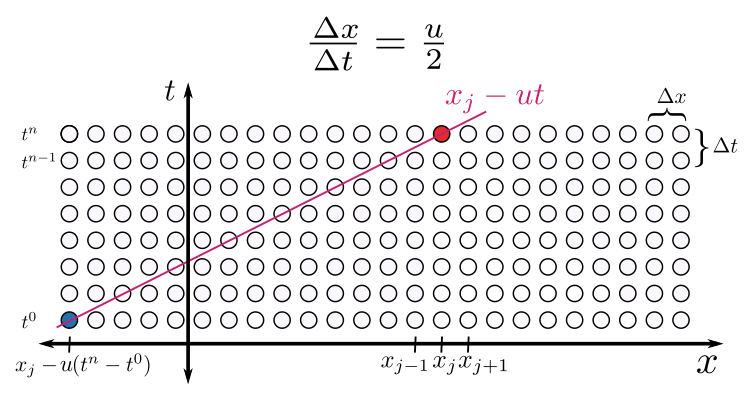</img></center>

<center> <b>Figura 1:</b> Dominio de dependencia para el operador continuo, dado por la línea magenta. Se resaltaron en rojo el punto que desea evolucionarse en el tiempo y en azul la condición inicial correcta para dicho punto. </center>

Por simplicidad consideremos $u > 0$ (el argumento se revierte en caso que $u < 0$). Una consecuencia del razonamiento anterior, y que es físicamente intuitivo, es que para construir $(x_j, t^n)$ preciso haber utilizado la información para $x_\ell$, $\ell < j$. Si un esquema solo utiliza puntos a la derecha el valor obtenido para $x_j$, $(x_j, t^n)$ no dependerá de su condición inicial y dicho esquema no puede ser estable. Esto puede verse fácilmente considerando que, por el teorema de Lax–Richtmyer, si el esquema fuera estable y consistente debería ser convergente, pero no puede ser convergente si no cuenta con la información apropiada. Estos esquemas suelen denominarse de **aguas abajo** (o _downwind_ en inglés).

<center>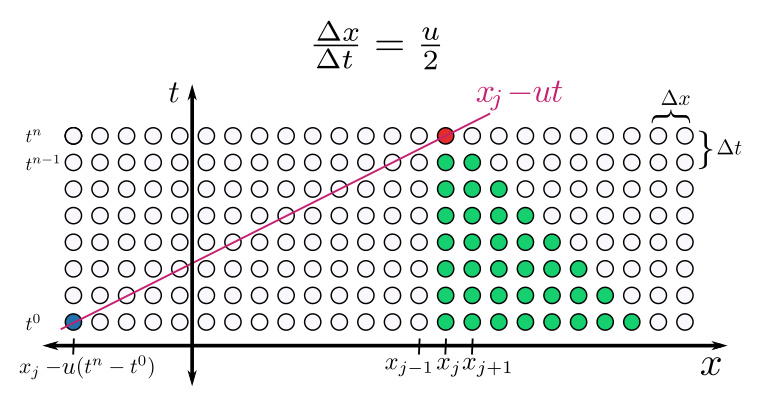</img></center>

<center><b> Figura 2:</b> Dominio de dependencia para un esquema aguas abajo (en verde), que utiliza solo información a la derecha del punto que se busca evolucionar (nuevamente, en rojo). Como se aprecia, este esquema no utiliza la condición inicial relevante (en azul) y deberá ser necesariamente inestable. Noten además que será inestable independientemente de la relación $\Delta x/\Delta t$.</center>

Consideremos ahora que el esquema utiliza solo puntos a la izquierda de $x_j$. Un ejemplo de un esquema de este estilo es Euler hacia atrás. Estos esquemas suelen denominarse de **aguas arriba** (_upwind_). Conjuguemos las derivadas calculadas de esta forma con un integrador de Euler adelantado, obteniendo el esquema
\begin{equation*}
    f^{n+1}_j = f^n_j + u \frac{\Delta t}{\Delta x} \left( f^n_j - f^n_{j-1}\right).
\end{equation*}
Grafiquemos ahora el dominio de dependencia de este último suponiendo $ \Delta x/\Delta t = u/2$

<center>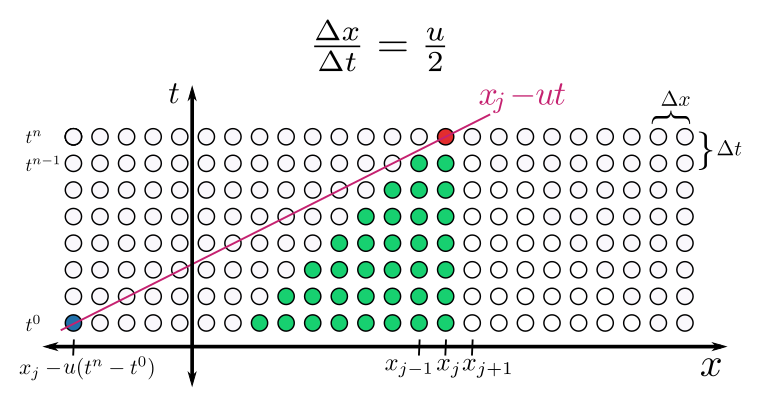</img></center>

<center><b> Figura 3:</b> Dominio de dependencia para el esquema aguas arriba de primer orden (en verde), que utiliza solo información a la derecha del punto que se busca evolucionar (nuevamente, en rojo). Como se aprecia, este esquema no utiliza la condición inicial relevante (en azul) y deberá ser necesariamente inestable. </center>

como se ve, este esquema tampoco podría ser estable ya que la solución para $(x_j, t^n)$ no depende de la condición inicial para la solución. Sin embargo, si consideramos ahora que la grilla obedece $\Delta x / \Delta t = 2u$ obtenemos el siguiente dominio de dependencia

<center>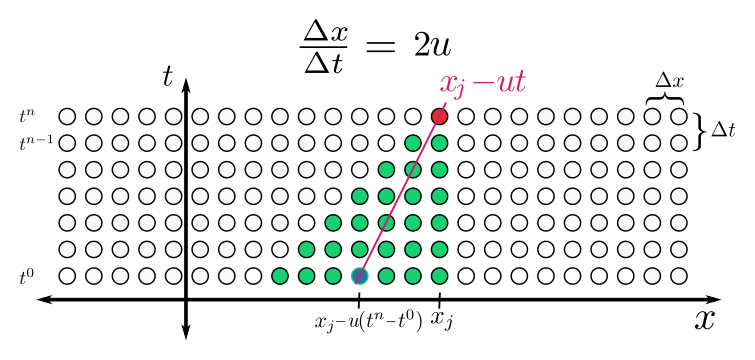</img></center>

<center><b> Figura 4:</b> Dominio de dependencia para el esquema aguas arriba de primer orden (en verde), pero considerando ahora una grilla que verifica $\Delta x / \Delta t = 2u$. Como se aprecia, este esquema utiliza la condición inicial relevante (en azul con línea verde) y podría ser estable. </center>

y por tanto el esquema contiene información sobre la condición inicial correcta y por tanto podría ser estable (y, de hecho, puede mostrarse fácilmente que lo es). Como caso límite, obtenemos que el esquema podrá ser estable para $\Delta x / \Delta t = u$.

Una forma general de escribir este resultado es que el dominio de dependencia del esquema numérico debe contener al dominio de dependencia del problema continuo.

Vale remarcar que, aunque útil para casos como la ecuación de advección o de ondas, para EDPs generales esta estrategia posee el inconveniente de que el dominio de dependencia no resulta sencillo de conocer. Más aún, para problemas parabólicos el dominio de dependencia puede ser infinito. En casos como este último, sin embargo, puntos infinitamente lejos tienen un efecto instantáneo pero despreciable sobre la solución y por lo tanto veremos en la próxima práctica que pueden construirse esquemas estables, aún cuando el problema discreto no contenga a todo el dominio de dependencia del problema continuo.

## Condiciones de contorno periódicas

Para mayor simplicidad, durante esta práctica vamos a considerar condiciones de contorno periódicas en todas las EDPs que consideraremos. Esto quiere decir que si el dominio espacial de la EDP es $x \in [0, L]$, tendremos que
\begin{equation}
    f^{(n)} (0) = f^{(n)} (L),
\end{equation}
donde $^{(n)}$ denota la $n$-ésima derivada (y para el caso $n=0$ denota a la propia función). Es decir, estamos pidiendo que sea suficientemente suave además de periódica.

Vale notar que bajo estas condiciones, todas las cantidades calculadas para $x=L$ resultan redundantes (son iguales a aquellas para $x=0$). Para problemas de este tipo resulta más ecónomico en memoria y más sencillo de programar trabajar con una grilla en el intervalo $[0, L)$ construida de manera tal que el siguiente punto de la grilla sería $L$. Esto podemos lograrlo fácilmente en Python con el siguiente código:

In [ ]:
import numpy as np
N = 10  # Cantidad de puntos
L = 1   # Extremo del intervalo

# endpoint=False, no incluir a L en la grilla generada
# retstep=True, devolver también dx
x, dx = np.linspace(0, L, N, endpoint=False, retstep=True)

print(x)         # Imprimo la grilla
print(x[-1]+dx)  # Imprimo el primer punto posterior a donde termina la grilla

[0.  0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1.0


<a name="fn_animado"></a>

### Animación de una solución a la ecuación de advección con condiciones de contorno periódicas

Para fijar ideas, veamos como es una solución a la ecuación de advección con condiciones de contorno periódicas. Consideremos que la condición inicial es
\begin{equation*}
    f(x,0) = \left|x - \frac{1}{2} \right|.
\end{equation*}
Para esta condición inicial la solución al problema resulta
\begin{equation*}
    f(x,t) = \left| \mathrm{mod}_L (x-ct) - \frac{1}{2} \right|,
\end{equation*}
donde $\mathrm{mod}$ es la extensión a los números reales del operador módulo.

Para representar gráficamente la solución usando Python, podemos usar la siguiente función para realizar una animación.

<a name="grafico1d_animado"></a>

In [ ]:
def grafico1d_animado(abscisas, ordenadas, dt, leyendas=None, titulo="",
                      etiqueta_x="", etiqueta_y="", paso=1, rescalar=False):
    """
    Genera un gráfico animado 1D.

    Entrada:
        - `abscisas`:   arreglo 1D o lista de arreglos 1D con las abscisas para
                            cada conjunto de datos.
        - `ordenadas`:  arreglo de dimensión 2 con el valor de las ordenadas
                            para cada tiempo. La cantidad de filas corresponde
                            a la cantidad de niveles temporales y debe ser igual
                            para cada conjunto de datos. La cantidad de columnas
                            debe coincidir con la cantidad de elementos en las
                            abscisas.
        - `dt`:         paso temporal entre muestras.
        - `leyendas`:   string o lista de strings con la etiqueta para cada set
                            de datos.
        - `titulo`:     string con el título del gráfico.
        - `etiqueta_x`: string con la etiqueta para el eje x [OPCIONAL].
        - `etiqueta_y`: string con la etiqueta para el eje y [OPCIONAL].
        - `paso`:       espaciamiento en los datos para cada fotograma.
        - `rescalar`:   True para recalcular los limites de la figura en cada
                            fotograma.
    
    Salida:
        - `anim`:   referencia al objeto de animación creado.
    """

    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.animation as animation

    #   Control de errores y flexibilidad para permitir uno o varios
    # sets de datos.
    if not isinstance(abscisas, list):
        if not isinstance(abscisas, np.ndarray):
            print("El primer argumento de `grafico1d_animado` debe ser un "
                  "arreglo con las abscisas o una lista de arreglos.")
            raise
        else:
            abscisas = [abscisas]

    if (not isinstance(ordenadas, list)):
        if (not isinstance(ordenadas, np.ndarray)):
            print("El segundo argumento de `grafico1d_animado` debe ser un "
                  "arreglo con los datos o una lista de arreglos.")
            raise
        else:
            ordenadas = [ordenadas]

    if len(abscisas) != len(ordenadas):
        print("La cantidad de arreglos de abscisas y de ordenadas debe "
              "ser la misma.")
        raise

    if leyendas and isinstance(leyendas, list):
        if len(ordenadas) != len(leyendas):
            print("Ordenadas y leyendas deben tener la misma cantidad de ", 
                  "elementos.")
            raise
    else:
        leyendas = [leyendas]

    # Guardo el estado de plt
    params_viejos = plt.rcParams
    plt.rc('animation', html='jshtml')

    num_foto = ordenadas[0].shape[0]

    fig, ax = plt.subplots(1, 1, figsize=(8,4), constrained_layout=True)
    plt.close();  # Cerrar la figura, animation va a crear la suya propia

    # Inicializo las curvas
    plots = [ ax.plot([], [], label=leyendas[i])[0]
              for i in range(len(ordenadas)) ]
    ax.set_title(titulo + f" $t=0$")
    ax.set_xlabel(etiqueta_x)
    ax.set_ylabel(etiqueta_y)

    def init():
        """ Inicializador de la figura y gráfico de condiciones iniciales."""
        for i, (x, f) in enumerate(zip(abscisas, ordenadas)):
            plots[i].set_xdata(x)
            plots[i].set_ydata(f[0])
        
        ax.relim()
        ax.autoscale_view()

        return plots

    def actualizar(t):
        """ Actualiza los datos al fotograma actual."""        
        print(f"\rCalculando fotograma {t//paso} de {(num_foto-1)//paso}",
              end="")
        for i, f in enumerate(ordenadas):
            plots[i].set_ydata(f[t])
        
        ax.set_title(titulo + f" $t={t*dt:.5f}$")
        
        if rescalar:
            ax.relim()
            ax.autoscale_view()

        return plots

    anim = animation.FuncAnimation(fig, actualizar, init_func=init,
                                   frames=range(0, num_foto, paso),
                                   blit=True, repeat=True)

    # Restauro el estado de plt
    plt.rc(params_viejos)

    return anim

Para ver una representación animada de la solución pueden correr el siguiente código (su ejecución demora aproximadamente 2 minutos).

In [ ]:
import numpy as np

N  = 128     # Cantidad de puntos
dt = 2.5e-2  # Frecuencia de muestreo
u  = .5      # Velocidad de advección
tf = 5       # Tiempo final de medición

x_0 = 0      # Extremo izquierdo del intervalo
x_1 = 1      # Estremo derecho del intervalo

x = np.linspace(x_0, x_1, N, endpoint=False)  # Grilla periódica
t = np.arange(int(round(tf/dt))+1)*dt         # Tiempo de cada fotograma

f = np.abs( ( (x[None,:] - u*t[:,None]) % (x_1-x_0) ) - (x_1-x_0)/2)

grafico1d_animado(x, f, dt, "Solución", "Solución a la ecuación de advección",
                  "$x$", "$t$")

Calculando fotograma 200 de 200

_Nota: para comenzar la reproducción deben clickear en $▶$, mientras que pueden usar $⏸$ para pausar la reproducción o $+$ y $-$ para aumentar o disminuir la velocidad de la misma, respectivamente._

<a name="rk"></a>

## Integrador de Runge-Kutta de orden arbitrario

En la práctica anterior introdujimos los métodos de Runge-Kutta de una forma tradicional, donde, por ejemplo, el método de cuarto orden precisa 4 variables temporales. Para resolver una ODE esto no suele ser un limitante. Sin embargo, a la hora de resolver PDEs para tres dimensiones espaciales, cada uno de esos arreglos temporales puede requerir varios Gigabytes de memoria RAM.

Para suplir este defecto (y mejorar el rendimiento al mismo tiempo), existen otros algoritmos de la familia de Runge-Kutta que permiten reducir la huella de memoria. Entre ellos, el siguiente resulta extremadamente sencillo de programar para problemas autónomos (i.e. que no dependen explícitamente del tiempo)

```
// Sea y^n un valor conocido, integro hasta y^{n+1} usando
y^{n+1} := y^n
Para o en (ORDEN, ORDEN-1, ... , 1) realizo:
    y^{n+1} := y^n + f(y^{n+1})*dt/o
Fin del bucle
// Obtuve y^{n+1}
```
Este algoritmo permite pasar del paso `n` al paso `n+1` realizando la integración con un orden global `ORDEN`. Vale recalcar, sin embargo, que aunque sencillo, este esquema conserva el orden **solo para EDOs lineales**, reduciendose el mismo a orden 2 en caso que la EDO sea cuadrática. Naturalmente, en caso que `ORDEN=1`, el esquema es de orden 1 para cualquier tipo de EDO, ya que se reduce a Euler adelantado. Por otra parte, pueden comprobar fácilmente que para `ORDEN=2` el esquema se reduce al clásico algoritmo de Runge-Kutta de segundo orden de punto medio (_midpoint_) presentado en la práctica 2.

Veamos el funcionamiento de este esquema integrando la ecuación de Bernoulli
\begin{equation*}
    \dot{y} = by^2 - y, \qquad \qquad y(0) =  \begin{cases}
    1 \qquad & \text{si } b=0 \\
    1/b \qquad &\text{si } b\ne 0
\end{cases},
\end{equation*}
cuya solución resulta
\begin{equation*}
    y = \frac{1}{b+e^t}.
\end{equation*}
Utilizando el algoritmo propuesto resolvamos esta ecuación para diversos valores de $\Delta t$ y diversos órdenes, y considerando los casos particulares $b=0$ (lineal) y $b=1$ (no-lineal). Para eso podemos usar el siguiente código:

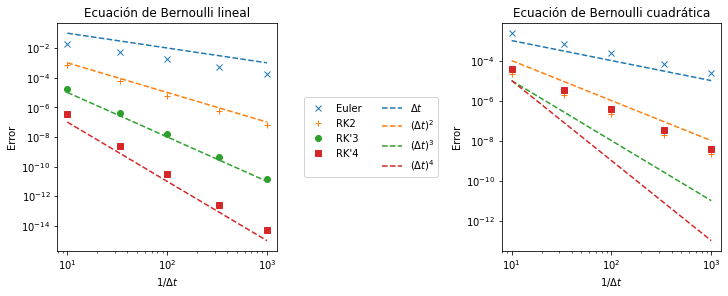

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Órdenes a explorar
ORDS = np.array([1, 2, 3, 4])

# Pasos temporales a explorar y tiempo final de integración
dts = np.array([1e-1, 3e-2, 1e-2, 3e-3, 1e-3])
tf  = 1

# Arreglos para guardar los errores
err_lin  = np.zeros( (ORDS.size, dts.size) )
err_nlin = np.zeros( (ORDS.size, dts.size) )

for i, dt in enumerate(dts):
    # Cantidad de pasos de integración y vector de tiempos
    pasos = int(round(tf/dt))
    t     = np.arange(pasos+1)*dt
    
    # Soluciones analíticas
    y_lin  = np.exp(-t)
    y_nlin = 1/(np.exp(t) + 1)

    for j, ORD in enumerate(ORDS):
        # Arrays para ir guardando la integración
        rk_lin  = np.zeros( (pasos+1) )
        rk_nlin = np.zeros( (pasos+1) )

        # Condiciones iniciales
        rk_lin[0]  = y_lin[0]
        rk_nlin[0] = y_nlin[0]

        # Integro para todo tiempo
        for n in range(pasos):
            # Asignación inicial
            rk_lin[n+1]  = rk_lin[n]
            rk_nlin[n+1] = rk_nlin[n]

            # Hago la cantidad de etapas dadas por el orden
            for o in range(ORD, 0, -1):
                rk_lin[n+1]  = rk_lin[n]  - rk_lin[n+1]*dt/o
                rk_nlin[n+1] = rk_nlin[n] + (rk_nlin[n+1]**2 - rk_nlin[n+1])*dt/o
        
        # Agrego el error para este dt y este orden
        err_lin[j,i]  = np.max(np.abs(rk_lin  - y_lin))
        err_nlin[j,i] = np.max(np.abs(rk_nlin - y_nlin))

# Creo la figura y los pares de ejes
fig, axs = plt.subplots(1, 2, figsize=(10,4), constrained_layout=True)

# LINEAL
# Errores en función de 1/Δt
axs[0].loglog(1/dts, err_lin[0], 'x', label="Euler")
axs[0].loglog(1/dts, err_lin[1], '+', label="RK2")
axs[0].loglog(1/dts, err_lin[2], 'o', label="RK'3")
axs[0].loglog(1/dts, err_lin[3], 's', label="RK'4")
# Leyes de potencia
axs[0].loglog(1/dts, dts**1,      '--', C="C0", label="$\Delta t$")
axs[0].loglog(1/dts, 1e-1*dts**2, '--', C="C1", label="$(\Delta t)^2$")
axs[0].loglog(1/dts, 1e-2*dts**3, '--', C="C2", label="$(\Delta t)^3$")
axs[0].loglog(1/dts, 1e-3*dts**4, '--', C="C3", label="$(\Delta t)^4$")

# NO-LINEAL
# Errores en función de 1/Δt
axs[1].loglog(1/dts, err_nlin[0], 'x', label="Euler")
axs[1].loglog(1/dts, err_nlin[1], '+', label="RK2")
axs[1].loglog(1/dts, err_nlin[2], 'o', label="RK'3")
axs[1].loglog(1/dts, err_nlin[3], 's', label="RK'4")
# Leyes de potencia
axs[1].loglog(1/dts, 1e-2*dts**1, '--', C="C0", label="$\Delta t$")
axs[1].loglog(1/dts, 1e-2*dts**2, '--', C="C1", label="$(\Delta t)^2$")
axs[1].loglog(1/dts, 1e-2*dts**3,      '--', C="C2", label="$(\Delta t)^3$")
axs[1].loglog(1/dts, 1e-1*dts**4, '--', C="C3", label="$(\Delta t)^4$")

# Leyenda, titulos, etiquetas
axs[0].legend(ncol=2, loc="center left", bbox_to_anchor=(1.1, .5))
[ax.set_xlabel("$1/\Delta t$") for ax in axs]
[ax.set_ylabel("Error") for ax in axs]
axs[0].set_title("Ecuación de Bernoulli lineal")
axs[1].set_title("Ecuación de Bernoulli cuadrática");

Vale mencionar que en la leyenda utilizamos la notación RK' para denotar que el método es del orden detallado solo para el caso lineal (noten que esto solo aplica a los casos de tercer y cuarto orden).

Vemos que, efectivamente, el método mantiene el orden propuesto para ecuaciones lineales, mientras que el orden se reduce a, como mucho, 2, cuando la ecuación es cuadrática.

Dado que las PDEs que veremos en esta y la siguiente práctica son lineales, les recomendamos que, salvo mención explícita de lo contrario, implementen este esquema para integrar en tiempo, ya que les permitirá probar fácilmente otros órdenes de integración temporal.

Vale mencionar que este método admite correcciones para recuperar ordenes mayores a 2 en presencia no-linealidades cuadráticas, como pueden leer en el siguiente trabajo: [_High-order low-storage explicit Runge-Kutta schemes for equations with quadratic nonlinearities_](https://arxiv.org/abs/0808.1883). También existen otros métodos de este estilo (i.e. de bajo almacenamiento) que mantienen la precisión hasta ordenes mayores. Sin embargo, no son tan flexibles para programar y por eso no nos van a resultar de interés durante el curso. Quienes quieran leer sobre esto pueden leer el apéndice D.3 (_Time discretizations-- Low-storage schemes_) del libro _Spectral Methods: Evolution to Complex Geometries and Applications to Fluid Dynamics_ de C.A. Canuto; M.Y. Hussaini; A. Quarteroni y T.A. Zang, editado por Springer.

<a name="sparse"></a>

## Almacenamiento y operación eficiente de matrices ralas en Python

Como mencionamos en prácticas anteriores,las representaciones que ofrece Numpy para matrices que contienen una gran cantidad de ceros, resultan poco eficientes. Reparar en esto es de interés para esta práctica, ya que la representación matricial de los operadores que vamos a estar utilizando para el cálculo de derivadas espaciales presentan muy pocos elementos no nulos. Por ejemplo, para una grilla espacial de 1024 puntos y una diferencia finita de primer orden, casi el 99,9% de los elementos son nulos (1.046.528 elementos).

Una manera de solucionar esto, manteniendo la expresividad y el rendimiento$^\dagger$ que la formulación matricial presenta es utilizando el módulo [`sparse`](https://docs.scipy.org/doc/scipy/reference/sparse.html) de la biblioteca `scipy`, que viene instalado en Google Colab por defecto.

En particular, nos van a interesar representar de manera óptima matrices cuyos elementos no nulos se hallan sobre alguna diagonal, para ello podemos utilizar [`scipy.sparse.diags`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.sparse.diags.html). El primer argumento a esta función es una lista de listas (o una lista de arreglos), conteniendo los elementos que deben colocarse sobre cada subdiagonal. En caso que proporcionemos un único número, el mismo se repite sobre la subdiagonal escogida. Luego, el argumento opcional `offsets` es una lista que mapea los valores proporcionados en el primer argumento con la subdiagonal donde deseamos asignar los mismos. Finalmente, también nos será de utilidad el argumento opcional `shape` que establece las dimensiones de la matriz resultante.

Por ejemplo, el siguiente código genera la matriz
\begin{equation*}
    A = \begin{pmatrix}
    2 & 1 & 0 & 3 \\
    3 & 2 & 1 & 0 \\
    0 & 3 & 2 & 1 \\
    1 & 0 & 3 & 2
    \end{pmatrix}
\end{equation*}
y lo multiplica por el vector
\begin{equation*}
    b = \begin{pmatrix}
    1 \\
    2 \\
    3 \\
    4
    \end{pmatrix}
\end{equation*}

$^\dagger$: Nos referimos específicamente, como siempre, al rendimiento en Python, donde las operaciones vectorizadas suelen ejecutarse sensiblemente más rápido.

In [ ]:
import numpy as np
from scipy.sparse import diags
nx = 4

A = diags([ [3], [2], [1], [3], [1] ], offsets=[-1, 0, 1, nx-1, 1-nx],
          shape=(nx,nx))
print("Tipo de A", type(A))
print("A=\n", A.toarray())

b  = np.arange(1, 5)

print("b=", b)

prod = A @ b
print("A*b=", prod)

Tipo de A <class 'scipy.sparse.dia.dia_matrix'>
A=
   (1, 0)	3.0
  (2, 1)	3.0
  (3, 2)	3.0
  (0, 0)	2.0
  (1, 1)	2.0
  (2, 2)	2.0
  (3, 3)	2.0
  (0, 1)	1.0
  (1, 2)	1.0
  (2, 3)	1.0
  (0, 3)	3.0
  (3, 0)	1.0
b= [1 2 3 4]
A*b= [16. 10. 16. 18.]


Como pueden ver, **el arreglo ralo (_sparse_) de Scipy opera sin problemas con un arreglo denso de Numpy.**
Noten además que para ver la representación de `A` como matriz debemos usar el método `toarray()`. Caso contrario (pueden probarlo ustedes), les devuelve la representación interna de Scipy para ese arreglo.

Si bien existen otras formas de crear arreglos ralos, utilizaremos `diags` porque será simple para las matrices que vamos a precisar en la práctica, además de que permite a Scipy utilizar el contenedor más apropiado para la distribución de los datos (ubicación de valores nulos y no nulos) y elegir el mejor contenedor disponible.

Comparemos el uso de memoria de una matriz densa de Numpy y otra rala de Scipy.

In [ ]:
import numpy as np
from scipy.sparse import diags
import sys

N = 1024

A_numpy = np.eye(N, k=1, )
A_scipy = diags([ [1] ], offsets=[1], shape=(N,N))

print(f"Arreglo Numpy: {sys.getsizeof(A_numpy)} bytes.")
print(f"Arreglo Scipy: {sys.getsizeof(A_scipy)} bytes.")
print(f"Arreglo Numpy = Arreglo Scipy -> {np.all(A_numpy==A_scipy.toarray())}.")

Arreglo Numpy: 8388720 bytes.
Arreglo Scipy: 64 bytes.
Arreglo Numpy = Arreglo Scipy -> True.


Como ven, la diferencia es de un factor de orden $10^5$ (ya que además Scipy utiliza la información de que los elementos no nulos son todos iguales). Sin embargo, en el contexto de esta materia, nos interesará más el ahorro en el poder de cómputo que aquel en almacenamiento. La diferencia en el cómputo requerido para cada representación es objeto del Problema 2.

<a name="fourier"></a>

## Descomposición trigonométrica (Fourier)

### Generalidades

Como probablemente hayan visto en materias anteriores, una manera útil de representar una gran cantidad de funciones$^\dagger$ $f: \mathbb{C} \rightarrow \mathbb{C}$ es mediante una suma trigonométrica, i.e. mediante su [**_transformada de Fourier_**](https://es.wikipedia.org/wiki/Transformada_de_Fourier) $\hat f$, definida$^\ddagger$ como:
\begin{equation*}
    \hat{f}(k) = \int_{-\infty}^{\infty} f(x) e^{-i k x} \ \mathrm{d}x.
\end{equation*}
$k$ es un número de onda y $\hat{f}(k)$ (que es en general complejo) cuantifica con que amplitud y fase debe sumarse $e^{ikx}$ para recuperar $f$. Esto queda de manifiesto al escribir la relación inversa, que reconstruye $f$ a partir de sus componentes trigonométricas
\begin{equation*}
    f(x) = \frac{1}{2\pi} \int_{-\infty}^{\infty} \hat{f}(k) e^{ik x} \ \mathrm{d}k.
\end{equation*}

Puede mostrarse que, en caso que $f: \mathbb{R} \rightarrow \mathbb{R}$, se verifica la relación de hermiticidad
\begin{equation*}
    \hat f(-k) = \overline{\hat{f}(k)},
\end{equation*}
donde $\bar{}$ denota la operación de conjugación. Basta entonces con conocer $\hat{f}$ en la semirecta $k \ge 0$ para determinar completamente $f$.

Otra cantidad importante es el espectro de potencias $\mathcal{P}$ (la energía de cada modo trigonométrico) que queda entonces dada por
\begin{equation*}
    \mathcal{P} (k) = |\hat f(k)|^2.
\end{equation*}

Más adelante utilizaremos extensamente la representación trigonométrica de una función, ya que dada esta descomposición resulta extremadamente sencillo calcular la descomposición de su derivada. 

Adicionalmente, y más en línea con su uso en esta práctica, puede pensarse **informalmente** la amplitud de $|\hat{f}(k)|$ como qué tan relevante es en $f$ de la escala $2\pi/k$. Un método numérico que evoluciona incorrectamente en el tiempo $|\hat{f}(k)|$ para **_$\boldsymbol {k}$ chicos_** está distorsionando las escalas grandes de la solución numérica, comparada con la solución real, mientras que si evoluciona incorrectamente para **_$\boldsymbol {k}$ grandes_** fallará en reproducir los rasgos de la solución real en las escalas más pequeñas.

$^\dagger$: Una condición suficiente para que dicha condición exista es que $f$ sea de cuadrado integrable.

$^\ddagger$: A menos de convenciones en el factor de normalización y el signo en el exponente.

### Caso periódico (FFT)

En caso que la función en cuestión esté definida sobre un dominio periódico, su espectro Fourier (i.e. los valores de $k$ sobre los cuales $\hat{f}$ será en general no nulo) pasa a ser numerable. Si asumimos además que $f$ está definida también sobre un conjunto discreto$^\dagger$$^\ddagger$ y equiespaciado de puntos, las representaciones integrales previas pueden simplificarse a sumas, resultando
\begin{equation*}
    \hat{f}_n =\lim_{J \to \infty}  \frac{1}{\sqrt{J}}\sum_{j=0}^{J} f_j e^{-i {k_n} x_j}, \qquad \qquad f_j = \lim_{N \to \infty} \frac{1}{\sqrt{N}}\sum_{n=-N}^{N} \hat f_n e^{-i {k_n} x_j},
\end{equation*}
donde $f_j = f(x_j)$, $\hat f_n = f(k_n)$, $x_j = j L/J + x_0$ y $k_n = n 2 \pi /L$, y se considero que la función periódica está definida en el intervalo $[x_0, x_0 + L)$.  Noten además que si consideramos $x_0 = 0$, $k_n x_j$ resulta
\begin{equation*}
    k_n x_j = n \frac{2 \pi}{L} j \frac{L}{J} = 2 \pi \frac{nj}{J},
\end{equation*}
y el cálculo de $f_n$ se vuelve independiente de $L$. En caso que $x_0 \ne 0$ solo es necesario agregar [un factor que corrige la fase](https://es.wikipedia.org/wiki/Transformada_de_Fourier#Propiedades_b%C3%A1sicas) de $\hat{f}_n$.

Las expresiones anteriores, pueden resolverse numéricamente si se fija una cierta cantidad de puntos de grilla $x_j$ y de números de onda $k_n$. En general, es ventajoso utilizar una cantidad igual de puntos para ambos dominios, $N$, obteniendo entonces
\begin{equation*}
    \hat{f}_n = \sum_{j=0}^{N} f_j e^{-i n \frac{2\pi}{N} j }, \qquad \qquad f_j = \frac{1}{N} \sum_{n=-\lfloor N/2\rfloor}^{\lceil N/2 \rceil -1} \hat f_n e^{-i j \frac{2\pi}{N} n},
\end{equation*}
con $\lfloor \rfloor$ y $\lceil \rceil$ las funciones [piso](https://es.wikipedia.org/wiki/Funciones_de_parte_entera) y [techo](https://es.wikipedia.org/wiki/Funciones_de_parte_entera), respectivamente.

Estas expresiones pueden computarse de manera óptima mediante una estrategia conocida como **_Transformada Rápida de Fourier_** (TRF o _FFT_ por sus siglas en inglés). En adelante utilizaremos el término transformada para referirnos, de manera indistinta a la Transformada o Serie de Fourier de una función.

$^\dagger$: Como es el caso para las aproximaciones numéricas a funciones continuas que hacemos en este curso.

$^\ddagger$: Esta representación discreta puede pensarse también como el límite de una aproximación por cuadratura. En caso que $f$ sea analítica dicha cuadratura posee convergencia exponencial.

### FFT en Python

Resulta extremadamente sencillo calcular la FFT de una cierta señal en Python. Existen numerosos paquetes que realizan esta tarea, sin embargo nos concentraremos en la interfaz brindada por [`numpy.fft`](https://numpy.org/doc/stable/reference/routines.fft.html).

Para esto podemos usar la función [`numpy.fft.fft`](https://numpy.org/doc/stable/reference/generated/numpy.fft.fft.html#numpy.fft.fft) que calcula la descomposición de Fourier en una dimensión de un arreglo. En caso que dicho arreglo posea más de una dimensión, podemos seleccionar sobre cuál queremos realizar la transformada mediante el argumento `axes`. Por ejemplo, dado un arreglo `f[i,j]` donde el índice `i` corresponde a distintos tiempos y `j` a distintas posiciones en el espacio, podemos calcular la transformada de Fourier en espacio como `numpy.fft.fft(f, axis=1)`.

Como notarán, y conforme a lo que mencionamos anteriormente, no es necesario contar con información sobre el espaciamiento entre puntos para calcular la FFT, basta con que sean equiespaciados. Sin embargo, está información sí resulta necesaria para interpretar los valores $\hat{f}_n$ como el contenido espectral asociado al número de onda $k_n$. Numpy nos ofrece la función `numpy.fft.fftfreq` (donde freq denota frecuencia, el equivalente temporal al número de onda). Por ejemplo, si la señal original (en el espacio $x$) tenía `N` puntos y un espaciamiento `dx`, podemos obtener el vector $k$ como `2*numpy.pi*numpy.fft.fftfreq(N, d=dx)`. El factor de $2\pi$ interviene para expresar a los números de onda en unidades de $\text{rad}/\text{s}$ en lugar de $1/\text{s}$.

Dado un arreglo de $N$ cantidades, `numpy.fft.fft` devuelve un arreglo de $N$ cantidades. Adicionalmente, adopta la convención de que devuelve primero el espectro correspondiente al número de onda $k_n=0$, seguido de los elementos asociados a $k_n>0$ y finalmente aquellos asociados a $k_n < 0$. Este ordenamiento, por consistencia, es también seguido por `numpy.ffy.fftfreq`.

Veamos un código que calcula el espectro de Fourier de la función $f(x) = \mathrm{sen}(x) + \mathrm{sen}(9x)$, que es $2\pi$-periódica. Esperamos que este espectro presente picos para $|k|=3$ y $|k|=15$. Veamos que efectivamente es así:

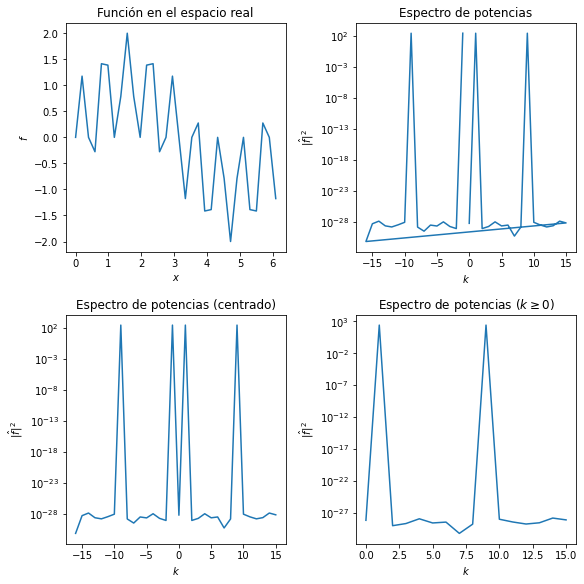

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

N = 32
x, dx = np.linspace(0, 2*np.pi, N, endpoint=False, retstep=True)
f = np.sin(x) + np.sin(9*x)

k = 2*np.pi*np.fft.fftfreq(N, d=dx)
F = np.fft.fft(f)

fig, axs = plt.subplots(2, 2, figsize=(8,8), constrained_layout=True)
axs[0,0].plot(x, f)
axs[0,0].set_title("Función en el espacio real")
axs[0,0].set_xlabel("$x$")
axs[0,0].set_ylabel("$f$")

axs[0,1].semilogy(k, np.abs(F)**2)
axs[0,1].set_title("Espectro de potencias")
axs[0,1].set_xlabel("$k$")
axs[0,1].set_ylabel("$|\hat f|^2$")

axs[1,0].semilogy(np.fft.fftshift(k), np.fft.fftshift(np.abs(F))**2)
axs[1,0].set_title("Espectro de potencias (centrado)")
axs[1,0].set_xlabel("$k$")
axs[1,0].set_ylabel("$|\hat f|^2$")

axs[1,1].semilogy(k[k>=0], np.abs(F[k>=0])**2)
axs[1,1].set_title(r"Espectro de potencias ($k \geq 0$)")
axs[1,1].set_xlabel("$k$")
axs[1,1].set_ylabel("$|\hat f|^2$");

Noten que el gráfico superior derecho presenta una discontinuidad cerca del 0 y una línea un tanto extraña que conecta los valores en los extremos de los intervalos. Esto se debe a que, como mencionabamos antes, Numpy organiza las cantidades de manera que primero aparecen los números de onda positivos y luego los negativos, generando estas discontinuidades al graficar. Para subsanar esto, podemos utilizar la función `numpy.fft.fftshift` que reacomoda los valores para que aparezcan primero aquellos asociados a $k < 0$ y luego aquellos con $k > 0$, quedando $k=0$ en el medio. Esta operación debemos realizarla tanto para el vector `k` como para el vector `F` (i.e. para la transformada de Fourier), de manera que su orden siga siendo consistente.

Finalmente, dada la relación de hermiticidad, ya que $f$ es real, sabemos que alcanza con estudiar el espectro de potencias para $k \ge 0$. Esto es lo que hace el último panel, donde graficamos solo para estas cantidades. Este tipo de gráficos, que consideran solo $k \ge 0$ son los que resultarán más apropiados para el estudio que deben realizar en el Problema 5.

Finalmente, vale mencionar que existen funciones que aprovechan la relación de hermiticidad para disminuir el costo de cómputo y de almacenamiento de las FFTs de funciones reales. Estas funcionalidades pueden accederse mediante las interfaces [`numpy.fft.rfft`](https://numpy.org/doc/stable/reference/generated/numpy.fft.rfft.html#numpy.fft.rfft) y [`numpy.fft.rfftfreq`](https://numpy.org/doc/stable/reference/generated/numpy.fft.rfftfreq.html#numpy.fft.rfftfreq). Sin embargo, dado que los ahorros que proporcionan no serán determinantes para la realización de las prácticas del curso, no será necesario que las empleen.

## Ejemplo integrador: Ecuación de onda

### Caso 1D

Para aplicar los conceptos anteriores, veamos como podemos construir un integrador para una ecuación hiperbólica diferente a las discutidas previamente. En particular, consideremos la ecuación de onda 1D:
\begin{equation*}
    \frac{\partial^2 f}{\partial x^2} - \frac{1}{c^2} \frac{\partial^2 f}{\partial t^2} = 0,
\end{equation*}
donde $c$ es la velocidad de propagación, con condiciones de contorno periódicas en el dominio $[0,4)$. Consideraremos además como condición inicial un pulso gaussiano 
\begin{equation*}
    f(0, x) = A \exp\left(- \frac{(x-x_0)^2}{4L_{x0}^2} \right),
\end{equation*}
y la condición
\begin{equation*}
    \frac{\partial f}{\partial t} (0, x) = 0.
\end{equation*}

Para evolucionar el sistema utilizaremos un método de líneas, donde discretizaremos el operador laplaciano mediante un cierto operador $\mathcal{L}$ y obtendremos el conjunto de ODEs dado por
\begin{equation*}
    \ddot{f}_{j} = c^2 \mathcal{L}[f_{j}].
\end{equation*}
Como siempre, usamos la notación $f_{j} = f(t, x_j)$. Llamando $g_{j} = f_{j}$, y $h_{j} = \dot{f}_{j}$ tendremos entonces el sistema
\begin{align*}
    \dot{g}_{j} &= h_{j}, \\
    \dot{h}_{j} &= c^2 \mathcal{L}[g_{j}].
\end{align*}

Evolucionaremos en el tiempo estas ecuaciones utilizando el esquema de Runge-Kutta de orden arbitrario descripto previamente. Por su parte, para el laplaciano discreto emplearemos aproximaciones en diferencias finitas centradas a la derivada segunda, de orden 2 o 4. Es decir, dada la matriz de diferenciación que estima la derivada segunda en función de $x$, $D_{xx}$, el operador $\mathcal L$ resultará
\begin{equation*}
    \mathcal L [g_j] = D_{xx} g_{j}.
\end{equation*}

El siguiente código realiza las operaciones mencionadas:


CFL = 0.0128


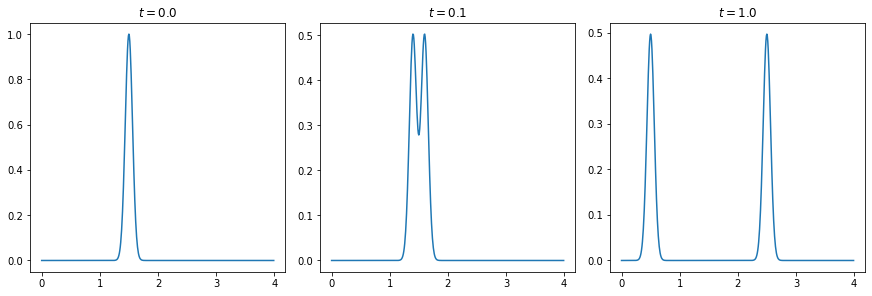

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def onda_rk4_1d(f0, x, c, dt, tf, orden_t=4, orden_x=4):
    """
    Función para integrar la ecuación de onda 1D sobre una grilla cartesiana
    equiespaciada empleando un método Runge-Kutta de orden 4.

    Entrada:
        Obligatoria
        - `f0`: Arreglo 2D con la condición inicial para cada punto (x,y) de
                    la grilla.
        - `x`:  Vector con la discretización en la dirección x (equiespaciada).
        - `c`:  Velocidad de propagación.
        - `dt`: Paso temporal.
        - `tf`: Tiempo final de integración

        Opcional
        - `orden_t`: Orden de la integración temporal (entre 1 y 4).
        - `orden_x`: Orden de la diferenciación espacial (2 o 4).
    
    Devuelve:
        - `f`: Arreglo 3D (t,ind,x) con la solución para f (ind=0) y ḟ(ind=1)
    """
    import numpy as np
    from scipy.sparse import diags

    # Cantidad de pasos temporales a realizar
    pasos = int(round(tf/dt))

    # Cantidad de puntos en cada dirección y espaciamiento de las grillas
    nx, dx = x.size, x[1]-x[0]
    
    # Matrices de diferenciación para la derivada segunda en la direcciones
    # x (D2x) e y (D2y).
    if orden_x == 2:                                  # Orden 2
        coefs   = [ [1], [-2], [1], [1], [1] ]
        offsets = [ -1, 0, 1, nx-1, 1-nx ]
        Dxx     = 1/(dx**2)*diags(coefs, offsets=offsets, shape=(nx, nx))

    elif orden_x == 4:                                # Orden 4
        coefs   = [ [-1], [16], [-30], [16], [-1], [-1], [16], [16], [-1] ]
        offsets = [ -2, -1, 0, 1, 2, nx-2, nx-1, 1-nx, 2-nx ]
        Dxx     = 1/(12*dx**2)*diags(coefs, offsets=offsets, shape=(nx, nx))
    else:
        raise ValueError                              # Error
    
    # Arreglo para ir guardando la solución
    # El primer índice denota el tiempo, el segundo si se trata de g ([0]) o
    # h ([1]), el tercero la coordenada en x, el cuarto la coordenada en y.
    f      = np.zeros( (pasos+1, 2, nx) )
    f[0,0] = f0                                # Condición inicial

    # Comienzo a integrar. Uso el método de Runge-Kutta descripto previamente.
    for n in range(0, pasos):
        f[n+1] = f[n]
        for o in range(orden_t, 0, -1):
            f[n+1,0] = f[n,0] + f[n+1,1]*dt/o
            f[n+1,1] = f[n,1] + c**2*(Dxx @ f[n+1,0])*dt/o

    return f

ORD_X = 4         # Orden espacial
ORD_T = 4         # Orden temporal

NX = 512          # Cantidad de puntos en x
LX = 4            # Longitud del dominio en x
dt = 1e-4         # Paso temporal

c  = 1            # Velocidad de propagación
tf = 1            # Tiempo final de integración

# Parámetros de la condición inicial
A, Lx0, x0 = 1, 0.25, 1.5

# Tiempos para los cuales grafico la solución
t1, t2     = .1, 1
ind1, ind2 = int(round(t1/dt)), int(round(t2/dt))

# Creo la grilla espacial
x, dx = np.linspace(0, LX, NX, endpoint=False, retstep =True)

print("CFL =", c*dt/dx)  # Imprimo CFL

# Cantidad de pasos de integración y vector de tiempos
pasos = int(round(tf/dt))
t     = np.arange(pasos+1)*dt

# Por conveniencia defino una función G que es una gaussiana con los parámetros
# escogidos.
G = lambda r: A*np.exp( - ((r % LX - x0)/np.sqrt(2)/Lx0**2)**2 )

# Condición inicial
f0 = G(x)

# Integro
f = onda_rk4_1d(f0, x, c, dt, tf, orden_t=ORD_T, orden_x=ORD_X)

# Grafico (sin muchos detalles, solo para ver que la solución es razonable)
fig, axs = plt.subplots(1, 3, figsize=(12,4), constrained_layout=True)
axs[0].plot(x, f[0,0])
axs[1].plot(x, f[ind1,0])
axs[2].plot(x, f[ind2,0])
axs[0].set_title(f"$t={t[0]}$")
axs[1].set_title(f"$t={t[ind1]}$")
axs[2].set_title(f"$t={t[ind2]}$");

Veamos una solución animada (precisarán ejecutar el código de bloque que define [`grafico1d_animado`](#fn_animado))

In [ ]:
grafico1d_animado(x, f[:,0], dt, titulo="Solución numérica a la ecuación de "+\
                  "onda 1D", etiqueta_x="$x$", etiqueta_y="$f$",
                  paso=int(5e-3/dt))

Calculando fotograma 200 de 200

### Caso 2D

Finalmente, como ejemplo ilustrativo, consideremos la ecuación de onda 2D:
\begin{equation*}
    \frac{\partial^2 f}{\partial x^2} + \frac{\partial^2 f}{\partial y^2} - \frac{1}{c^2} \frac{\partial^2 f}{\partial t^2} = 0,
\end{equation*}
donde $c$ es la velocidad de propagación, con condiciones de contorno periódicas en el dominio $(x;y) = [0,1)\times [0,1)$. Resolvamos esta ecuación utilizando como valor inicial un pulso gaussiano 
\begin{equation*}
    f(0, x, y) = A \exp\left(- \frac{(x-x_0)^2}{4L_{x0}^2} - \frac{(y-y_0)^2}{4L_{y0}^2} \right),
\end{equation*}
y la condición
\begin{equation*}
    \frac{\partial f}{\partial t} (0, x, y) = 0.
\end{equation*}

Al igual que antes utilizaremos el método de líneas obteniendo el conjunto de ODEs dado por
\begin{equation*}
    \ddot{f}_{ij} = c^2 \mathcal{L}[f_{ij}],
\end{equation*}
donde ahora $\mathcal{L}$ es una aproximación discreta del laplaciano bidimensional. Reduciendo el orden de las ecuaciones en tiempo obtenemos
\begin{align*}
    \dot{g}_{ij} &= h_{ij}, \\
    \dot{h}_{ij} &= c^2 \mathcal{L}[g_{ij}].
\end{align*}

Para evolucionar en tiempo estas ecuaciones utilizaremos el mismo esquema de Runge-Kutta del ejemplo anterior. Por su parte, para el laplaciano discreto combinaremos aproximaciones en diferencias finitas centradas a la derivada segunda, de orden 2 o 4. Es decir, dadas las matrices de diferenciación que estiman la derivada segunda en función de $x$, $D_{xx}$, y en función de $y$, $D_{yy}$, el operador $\mathcal L$ resultará
\begin{equation*}
    \mathcal L [G] = D_{xx} G + G D^t_{yy},
\end{equation*}
donde $^t$ denota transposición y $G$ es la matriz $G_{ij} = g_{ij}$.

El siguiente código realiza las operaciones mencionadas:


CFL = 0.0512


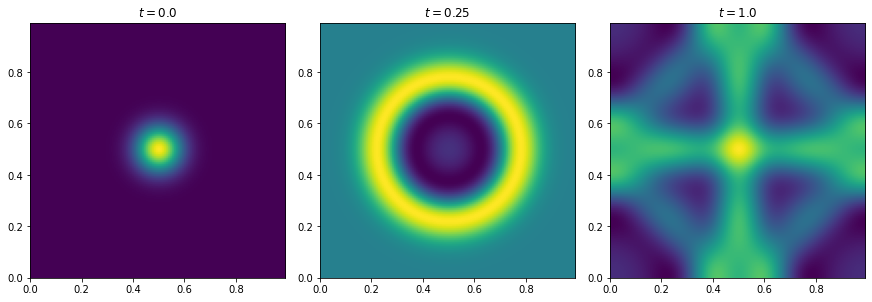

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def onda_rk4_2d(f0, x, y, c, dt, tf, orden_t=4, orden_xy=4):
    """
    Función para integrar la ecuación de onda 2D sobre una grilla cartesiana
    equiespaciada empleando un método Runge-Kutta de orden 4.

    Entrada:
        Obligatoria
        - `f0`: Arreglo 2D con la condición inicial para cada punto (x,y) de
                    la grilla.
        - `x`:  Vector con la discretización en la dirección x (equiespaciada).
        - `y`:  Vector con la discretización en la dirección y (equiespaciada).
        - `c`:  Velocidad de propagación.
        - `dt`: Paso temporal.
        - `tf`: Tiempo final de integración

        Opcional
        - `orden_t`:  Orden de la integración temporal (entre 1 y 4).
        - `orden_xy`: Orden de la diferenciación espacial (2 o 4).
    
    Devuelve:
        - `f`: Arreglo 3D con la solución para cada (t,x,y).
    """
    import numpy as np
    from scipy.sparse import diags

    # Cantidad de pasos temporales a realizar
    pasos = int(round(tf/dt))

    # Cantidad de puntos en cada dirección y espaciamiento de las grillas
    nx, dx = x.size, x[1]-x[0]
    ny, dy = y.size, y[1]-y[0]

    # Arreglos 2D con las coordenadas x (X) e y (Y) de cada punto de la grilla
    # bidimensional. Vuelven más sencillo evaluar la condición inicial.
    X, Y = np.meshgrid(x, y, indexing="ij")

    # Matrices de diferenciación para la derivada segunda en la direcciones
    # x (D2x) e y (D2y).
    if orden_xy == 2:                                  # Orden 2
        coefs     = [ [1], [-2], [1], [1], [1] ]
        offsets_x = [ -1, 0, 1, nx-1, 1-nx ]
        Dxx       = 1/(dx**2)*diags(coefs, offsets=offsets_x, shape=(nx, nx))

        offsets_y = [ -1, 0, 1, ny-1, 1-ny ]
        Dyy       = 1/(dy**2)*diags(coefs, offsets=offsets_y, shape=(ny, ny)).T    
    elif orden_xy == 4:                                # Orden 4
        coefs     = [ [-1], [16], [-30], [16], [-1], [-1], [16], [16], [-1] ]
        offsets_x = [ -2, -1, 0, 1, 2, nx-2, nx-1, 1-nx, 2-nx ]
        Dxx       = 1/(12*dx**2)*diags(coefs, offsets=offsets_x, shape=(nx, nx))

        offsets_y = [ -2, -1, 0, 1, 2, ny-2, ny-1, 1-ny, 2-ny ]
        Dyy       = 1/(12*dy**2)*diags(coefs, offsets=offsets_y, shape=(ny, ny))
        Dyy       = Dyy.T
    else:
        raise ValueError                              # Error

    # Arreglo para ir guardando la solución
    # El primer índice denota el tiempo, el segundo si se trata de g ([0]) o
    # h ([1]), el tercero la coordenada en x, el cuarto la coordenada en y.
    f      = np.zeros( (pasos+1, 2, nx, ny) )
    f[0,0] = f0                                # Condición inicial

    # Comienzo a integrar. Uso el método de Runge-Kutta descripto previamente.
    for n in range(0, pasos):
        f[n+1] = f[n]
        for o in range(orden_t, 0, -1):
            f[n+1,0] = f[n,0] + f[n+1,1]*dt/o
            f[n+1,1] = f[n,1] + c**2*(Dxx @ f[n+1,0] + f[n+1,0] @ Dyy)*dt/o
    return f

ORD_XY = 4         # Orden espacial
ORD_T  = 4         # Orden temporal

NX, NY = 128, 128  # Cantidad de puntos en cada dirección
LX, LY = 1, 1      # Longitud del dominio en cada dirección
dt     = 2.5e-3    # Paso temporal

c  = 1             # Velocidad de propagación
tf = 1             # Tiempo final de integración

# Parámetros de la condición inicial
A, Lx0, Ly0, x0, y0 = 1, 0.25, 0.25, 0.5, 0.5 

# Tiempos para los cuales grafico la solución
t1, t2     = .25, 1
ind1, ind2 = int(round(t1/dt)), int(round(t2/dt))

# Creo las grillas unidimensionales
x, dx = np.linspace(0, LX, NX, endpoint=False, retstep =True)
y, dy = np.linspace(0, LY, NY, endpoint=False, retstep =True)

# Arreglos 2D con las coordenadas x (X) e y (Y) de cada punto de la grilla
# bidimensional. Vuelven más sencillo evaluar la condición inicial.
X, Y = np.meshgrid(x, y, indexing="ij")

print("CFL =", c**2*dt**2/(dx**2+dy**2))  # Imprimo CFL

# Cantidad de pasos de integración y vector de tiempos
pasos = int(round(tf/dt))
t     = np.arange(pasos+1)*dt

# Por conveniencia defino una función G que es una gaussiana con los parámetros
# escogidos.
G = lambda r: A*np.exp( - ((r[0] % LX - x0)/np.sqrt(2)/Lx0**2)**2 -
                          ((r[1] % LY - y0)/np.sqrt(2)/Ly0**2)**2)

# Condición inicial
f0 = G( [X, Y] )

# Integro
f = onda_rk4_2d(f0, x, y, c, dt, tf, orden_t=ORD_T, orden_xy=ORD_XY)

# Grafico (sin muchos detalles, solo para ver que la solución es razonable)
fig, axs = plt.subplots(1, 3, figsize=(12,8), constrained_layout=True)
axs[0].imshow(f[0,0].T, origin="lower", extent=(x[0], x[-1], y[0], y[-1]))
axs[1].imshow(f[ind1,0].T, origin="lower", extent=(x[0], x[-1], y[0], y[-1]))
axs[2].imshow(f[ind2,0].T, origin="lower", extent=(x[0], x[-1], y[0], y[-1]))
axs[0].set_title(f"$t={t[0]}$")
axs[1].set_title(f"$t={t[ind1]}$")
axs[2].set_title(f"$t={t[ind2]}$");

Para una mejor visualización, el siguiente par de celdas genera una visualización animada de la solución obtenida:

In [ ]:
def grafico2d_animado(x, y, escalar, dt, titulo="", etiqueta_x="",
                      etiqueta_y="",etiqueta_escalar="", paso=1):
    """
    Genera un gráfico animado 2D.

    Entrada:
        - `x`:       arreglo 1D (NX) con las abscisas de los datos datos.
        - `y`:       arreglo 1D (NY) con las ordenadas de los datos datos.        
        - `escalar`: arreglo 2D (NX,NY) con los valores del campo escalar sobre
                     la grilla cartesiana.
        - `dt`:      paso temporal entre muestras.

        - `titulo`:           string con el título del gráfico [OPCIONAL].
        - `etiqueta_x`:       string con la etiqueta para el eje x [OPCIONAL].
        - `etiqueta_y`:       string con la etiqueta para el eje y [OPCIONAL].
        - `etiqueta_escalar`: string con la etiqueta del campo escalar 
                              [OPCIONAL].
        - `paso`:             espaciamiento en los datos para cada fotograma.
                              [OPCIONAL]
    
    Salida:
        - `anim`:   referencia al objeto de animación creado.
    """

    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.animation as animation

    # Guardo el estado de plt
    params_viejos = plt.rcParams
    plt.rc('animation', html='jshtml')

    num_foto =escalar.shape[0]

    fig, ax = plt.subplots(1, 1, figsize=(8,8), constrained_layout=True)
    plt.close();  # Cerrar la figura, animation va a crear la suya propia

    # Inicializo las curvas
    plot = ax.imshow( np.ones_like(X), extent=(x[0], x[-1], y[0], y[-1]),
                      origin="lower", interpolation='gaussian',
                      vmin=escalar.min(), vmax=escalar.max())

    cbar = fig.colorbar(plot, ax=ax, orientation="horizontal")
    cbar.set_label(etiqueta_escalar)

    ax.set_title(titulo + f" $t=0$")
    ax.set_xlabel(etiqueta_x)
    ax.set_ylabel(etiqueta_y)

    def init():
        """ Inicializador de la figura y gráfico de condiciones iniciales."""
        plot.set_data(escalar[0].T)
        return plot,

    def actualizar(t):
        """ Actualiza los datos al fotograma actual."""        
        print(f"\rCalculando fotograma {t//paso} de {(num_foto-1)//paso}",
              end="")
        plot.set_data(escalar[t].T)
        
        ax.set_title(titulo + f" $t={t*dt:.5f}$")
        return plot,

    anim = animation.FuncAnimation(fig, actualizar, init_func=init,
                                   frames=range(0, num_foto, paso),
                                   blit=False, repeat=True)

    # Restauro el estado de plt
    plt.rc(params_viejos)

    return anim

In [ ]:
grafico2d_animado(x, y, f[:,0], dt, titulo="Ecuación de onda",etiqueta_x="$x$",
                  etiqueta_y="$y$", etiqueta_escalar="$f$",
                  paso=int(round(5e-3/(c*dt))))

Calculando fotograma 200 de 200